In [1]:
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from glob import glob
import useful_functions as uf
import itertools

In [2]:
def generate_design(params, rename_index=False):
    """
    Genera un diseño de experimentos con todas las combinaciones posibles.

    Args:
        params (dict): Diccionario donde las claves son los nombres de los parámetros y
                      los valores son listas de la forma [inicio, fin, num_puntos, sensibilidad].
        rename_index (bool): Si es True, redefine los índices como Model_1, Model_2, ...

    Returns:
        pd.DataFrame: DataFrame con todas las combinaciones posibles de valores.
    """
    param_values = {
        key: np.round(np.linspace(value[0], value[1], value[2]), value[3])
        for key, value in params.items()
    }

    design = pd.DataFrame(
        [row for row in itertools.product(*param_values.values())],
        columns=param_values.keys()
    )
    
    if rename_index:
        design.index = [f"Model_{i+1}" for i in range(len(design))]
    else:
        design.index = range(1, len(design)+1)

    return design


def get_color_from_circle(img, center, radius, vis= False):
    mask = np.zeros(img.shape[:2], dtype=np.uint8)
    cv2.circle(mask, center, radius, 255, -1)
    masked_image = cv2.bitwise_and(img, img, mask=mask)
    mean_color = cv2.mean(masked_image, mask=mask)
    mean_color = tuple(int(x) for x in mean_color)[:3]
    if vis:
        f, ax = plt.subplots(figsize=(6, 6))
        cv2.circle(img, center, radius, (0, 255, 0), 2)  # Color verde para el círculo, grosor 2
        cv2.circle(img, center, 20, (0, 0, 0), 10)
        cv2.circle(img, center, 20, (mean_color[0], mean_color[1], mean_color[2]), -1)
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        ax.axis('off')
        plt.show()
    return mean_color

def img_cambiar_nombre_de_la_funcion(img, circulos, colors):
    mod_img = img.copy()
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 15))
    if colors is not None:
        for n , col in enumerate(colors):
            center = circulos[0][n][:2]
            radius = circulos[0][n][2]
            cv2.circle(mod_img, center, radius, (0, 255, 0), 2)
            cv2.circle(mod_img, center, 20, (0, 0, 0), 10)
            cv2.circle(mod_img, center, 20, (col[0], col[1], col[2]), -1)
            cv2.putText(mod_img, f'{radius}', center-np.array([10,0]), 0, .5, (0,0,0), 1)
            
    ax1.imshow(cv2.cvtColor(mod_img, cv2.COLOR_BGR2RGB))
    ax2.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.axis('off')
    ax2.axis('off')
    plt.show()

In [3]:
img_files = glob('training/*jpg')
print(img_files)
print(len(img_files))
print(img_files[0])

['training/tr_02_image_13.jpg', 'training/tr_02_image_1.jpg', 'training/tr_1_image_6.jpg', 'training/tr_05_image_13.jpg', 'training/tr_05_image_12.jpg', 'training/tr_1_image_7.jpg', 'training/tr_02_image_12.jpg', 'training/tr_02_image_10.jpg', 'training/tr_02_image_2.jpg', 'training/tr_1_image_5.jpg', 'training/test_image_9.jpg', 'training/tr_05_image_10.jpg', 'training/tr_05_image_11.jpg', 'training/test_image_8.jpg', 'training/tr_1_image_4.jpg', 'training/tr_02_image_3.jpg', 'training/tr_02_image_11.jpg', 'training/tr_005_image_12.jpg', 'training/tr_02_image_15.jpg', 'training/tr_02_image_7.jpg', 'training/tr_05_image_15.jpg', 'training/tr_05_image_14.jpg', 'training/tr_1_image_1.jpg', 'training/tr_02_image_6.jpg', 'training/tr_02_image_14.jpg', 'training/tr_005_image_13.jpg', 'training/tr_005_image_11.jpg', 'training/tr_02_image_16.jpg', 'training/tr_02_image_4.jpg', 'training/tr_1_image_3.jpg', 'training/tr_05_image_16.jpg', 'training/tr_05_image_8.jpg', 'training/tr_05_image_9.jpg

In [225]:
img_files_filter = list(filter(lambda x: 'tr_' in x, img_files)) # None tr_005 tr_01 tr_02 tr_05 tr_1 tr_2
# img_files_filter = [img_files_filter[0]]
# img_files_filter = ['tr_2_image_15']
# img_files_filter = img_files[:10]
uf.sort_list_of_fs_by_ascending_number(img_files_filter, r_pattern='image_')
print(img_files_filter)
print(len(img_files_filter))

['training/tr_02_image_1.jpg', 'training/tr_1_image_1.jpg', 'training/tr_2_image_1.jpg', 'training/tr_005_image_1.jpg', 'training/tr_01_image_1.jpg', 'training/tr_05_image_1.jpg', 'training/tr_02_image_2.jpg', 'training/tr_1_image_2.jpg', 'training/tr_2_image_2.jpg', 'training/tr_005_image_2.jpg', 'training/tr_01_image_2.jpg', 'training/tr_05_image_2.jpg', 'training/tr_02_image_3.jpg', 'training/tr_1_image_3.jpg', 'training/tr_005_image_3.jpg', 'training/tr_2_image_3.jpg', 'training/tr_01_image_3.jpg', 'training/tr_05_image_3.jpg', 'training/tr_1_image_4.jpg', 'training/tr_02_image_4.jpg', 'training/tr_01_image_4.jpg', 'training/tr_2_image_4.jpg', 'training/tr_005_image_4.jpg', 'training/tr_05_image_4.jpg', 'training/tr_1_image_5.jpg', 'training/tr_02_image_5.jpg', 'training/tr_01_image_5.jpg', 'training/tr_005_image_5.jpg', 'training/tr_2_image_5.jpg', 'training/tr_05_image_5.jpg', 'training/tr_1_image_6.jpg', 'training/tr_02_image_6.jpg', 'training/tr_01_image_6.jpg', 'training/tr_00

## funcion a crear

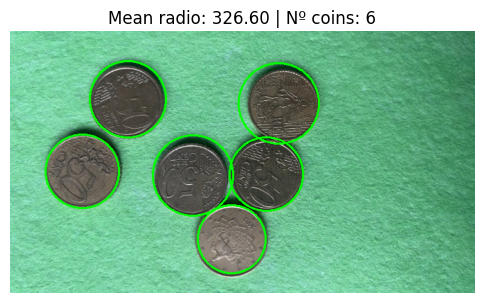

In [224]:
def get_circulos(image, median_blur=11, bilateral_filter=7, dp_=15, param2_=15):
    plot_below = False # True | False
    if plot_below:
        f, ax = plt.subplots(figsize=(6, 6))
        ax.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        ax.axis('off')
        ax.set_title('Imagen Original')
        plt.show()
        print(f'Image size: {img.shape}')
    ########################
    # imgPre = cv2.resize(image, None, fx = .7, fy=.7)
    imgPre = cv2.medianBlur(image, median_blur)
    imgPre = cv2.bilateralFilter(imgPre, bilateral_filter, 30, 125)

    plot_below = False# True | False
    if plot_below:
        f, ax = plt.subplots(figsize=(6, 6))
        ax.imshow(cv2.cvtColor(imgPre, cv2.COLOR_BGR2RGB))
        ax.axis('off')
        ax.set_title(f'Imagen Preprocesada: Median Blur: {median_blur}, Bilateral Filter: {bilateral_filter}'
                     f', dp: {dp_}, param2: {param2_}')
        plt.show()
    imgPre = cv2.cvtColor(imgPre, cv2.COLOR_BGR2GRAY)

    circulos = cv2.HoughCircles(
        imgPre,
        cv2.HOUGH_GRADIENT,
        dp=dp_,               # Inverso de la resolución acumuladora || 1.2
        minDist=80,           # Distancia mínima entre centros de círculos || 80
        param1=100,            # Umbral del detector de bordes Canny || 100
        param2=param2_,            # Umbral del acumulador (más bajo = más círculos detectados) || 15
        minRadius=40,         # Radio mínimo de los círculos || 40
        maxRadius=60          # Radio máximo de los círculos || 60
        )
    return circulos

def get_circs_info(circulos):
    return np.array([circulos[0,:,2].sum(), circulos.shape[1]])

def coins_visualization(img, circulos, circs_info):
    if circulos is not None:
        # circ_score = get_circs_info(circulos)
        circulos = np.uint16(np.around(circulos))
        
        img2_copy = img.copy()
        f, ax = plt.subplots(figsize=(6, 6))
        
        for n , cir in enumerate(circulos[0]):
            center = cir[:2]
            radius = cir[2]
            cv2.circle(img2_copy, center, radius, (0, 255, 0), 2)
        ax.imshow(cv2.cvtColor(img2_copy, cv2.COLOR_BGR2RGB))
        ax.set_title(f'Mean radio: {circs_info[0]:.2f} | Nº coins: {int(circs_info[1])}')
        

        ax.axis('off')
        plt.show()
    else:
        print('aqui no hay nadaaaaaaaaaaaaa !!!!!!!')
        

# for img_n in img_files_filter:
#     img = cv2.imread(img_n)
#     img = cv2.resize(img, None, fx = .7, fy=.7)
#     circulos = get_circulos(img, median_blur=5, bilateral_filter=12, dp_=.8, param2_=22)
#     circs_info = get_circs_info(circulos)
#     print(circs_info, circs_info[0]/circs_info[1])
#     coins_visualization(img, circulos, circs_info)

img_n = img_files_filter[1]
img = cv2.imread(img_n)
img = cv2.resize(img, None, fx = .7, fy=.7)
circulos = get_circulos(img, median_blur=5, bilateral_filter=12, dp_=.8, param2_=22)
circs_info = get_circs_info(circulos)
coins_visualization(img, circulos, circs_info)


In [232]:

def calcular_error_ponderado(medida_real, medida_obtenida, pesos, total=True):
    """
    Calcula el error total ponderado o el error de cada variable entre dos estructuras de datos (DataFrames o numpy arrays).
    
    :param medida_real: DataFrame, Series o numpy array con las medidas reales.
    :param medida_obtenida: DataFrame, Series o numpy array con las medidas obtenidas.
    :param pesos: Diccionario con los pesos para cada variable si se usan DataFrames, o un array si se usan numpy arrays.
    :param total: Booleano que determina si se devuelve el error total (True) o los errores individuales (False).
    :return: Error total ponderado promedio o diccionario con los errores individuales.
    """
    errores = {}
    
    if isinstance(medida_real, (pd.DataFrame, pd.Series)) and isinstance(medida_obtenida, (pd.DataFrame, pd.Series)):
        for columna, peso in pesos.items():
            if columna in medida_real and columna in medida_obtenida:
                error = (abs(medida_real[columna] - medida_obtenida[columna]) / medida_real[columna]).mean()
                errores[columna] = peso * error
            else:
                print(f"Advertencia: La columna '{columna}' no está en ambos DataFrames.")
    
    elif isinstance(medida_real, np.ndarray) and isinstance(medida_obtenida, np.ndarray):
        error = np.abs(medida_real - medida_obtenida) / medida_real
        errores = pesos * error.mean(axis=0)
    
    else:
        raise TypeError("Las entradas deben ser DataFrames, Series o numpy arrays del mismo tipo.")
    
    if total:
        return sum(errores.values()) if isinstance(errores, dict) else errores.sum()
    else:
        return errores


params = {'dp':[.5, 1.5, 11, 1], 'param2':[5, 25, 6,0]}
# params = {'dp':[.5, 1.5, 2, 1], 'param2':[5, 25, 2,0]}

its = generate_design(params, True)

medida_real = pd.read_excel('coins_data.xlsx', index_col=0)

pesos = {'area': 1, 'n_coins': 1}

for it_name,it_val in its.iterrows():
    datos_buenos = []
    resultados_algoritmo = []
    for img_num, img_n in enumerate(img_files_filter):
        img = cv2.imread(img_n)
        img_n = os.path.splitext(os.path.basename(img_n))[0]
        img = cv2.resize(img, None, fx = .7, fy=.7)
        circulos = get_circulos(img, median_blur=3, bilateral_filter=7, dp_=it_val[0], param2_=it_val[1])
        circs_info = get_circs_info(circulos)
        circs_info_excel = tuple(medida_real[medida_real.index == img_n].values.flatten())

        datos_buenos.append(circs_info_excel)
        resultados_algoritmo.append(tuple(circs_info))

    medida_obtenida = pd.DataFrame(resultados_algoritmo, columns=['area', 'n_coins'], index=medida_real.index)
    error_comb = calcular_error_ponderado(medida_real, medida_obtenida, pesos, total=True)
    if isinstance(error_comb, float):
        print(f'{it_name} | dp: {it_val[0]:.2f} | param2: {it_val[1]} | error_comb: {error_comb:.2f}')
        its.loc[it_name, 'Error'] = round(error_comb, 2)
    else:
        print(error_comb)

print(its)

Model_1 | dp: 0.50 | param2: 5.0 | error_comb: 8.37
Model_2 | dp: 0.50 | param2: 9.0 | error_comb: 4.05
Model_3 | dp: 0.50 | param2: 13.0 | error_comb: 0.69
Model_4 | dp: 0.50 | param2: 17.0 | error_comb: 0.45
Model_5 | dp: 0.50 | param2: 21.0 | error_comb: 0.44
Model_6 | dp: 0.50 | param2: 25.0 | error_comb: 0.43
Model_7 | dp: 0.60 | param2: 5.0 | error_comb: 8.37
Model_8 | dp: 0.60 | param2: 9.0 | error_comb: 4.05
Model_9 | dp: 0.60 | param2: 13.0 | error_comb: 0.69
Model_10 | dp: 0.60 | param2: 17.0 | error_comb: 0.45
Model_11 | dp: 0.60 | param2: 21.0 | error_comb: 0.44
Model_12 | dp: 0.60 | param2: 25.0 | error_comb: 0.43
Model_13 | dp: 0.70 | param2: 5.0 | error_comb: 8.37
Model_14 | dp: 0.70 | param2: 9.0 | error_comb: 4.05
Model_15 | dp: 0.70 | param2: 13.0 | error_comb: 0.69
Model_16 | dp: 0.70 | param2: 17.0 | error_comb: 0.45
Model_17 | dp: 0.70 | param2: 21.0 | error_comb: 0.44
Model_18 | dp: 0.70 | param2: 25.0 | error_comb: 0.43
Model_19 | dp: 0.80 | param2: 5.0 | error_c

In [233]:
its.to_excel('iterations_results.xlsx')

/var/folders/kb/2kjmxrfs0vn8rt7y7z6l4mwm0000gn/T/ipykernel_33885/1382894413.py:1: UserWarning: Pandas requires version '1.4.3' or newer of 'xlsxwriter' (version '1.3.9' currently installed).
  its.to_excel('iterations_results.xlsx')


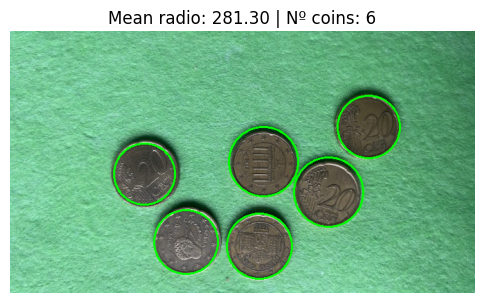

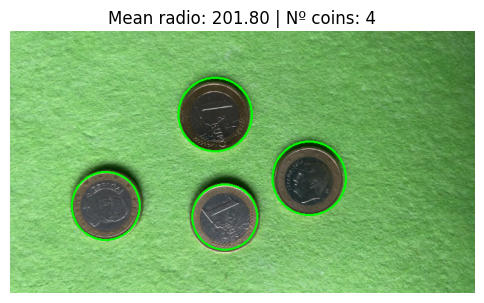

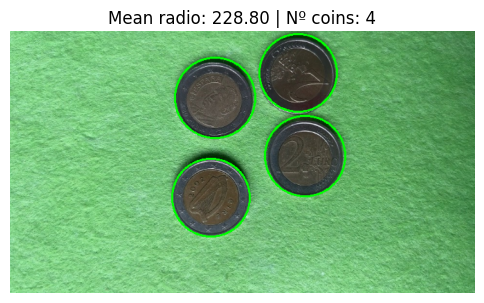

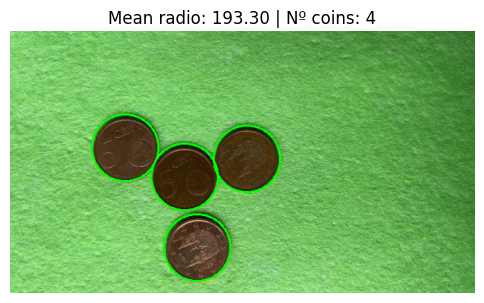

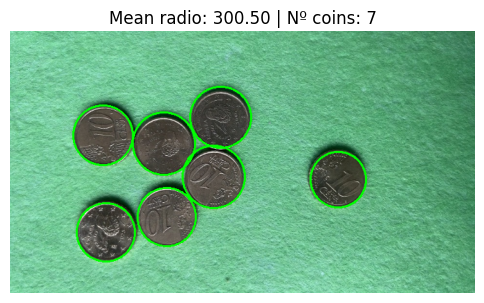

...

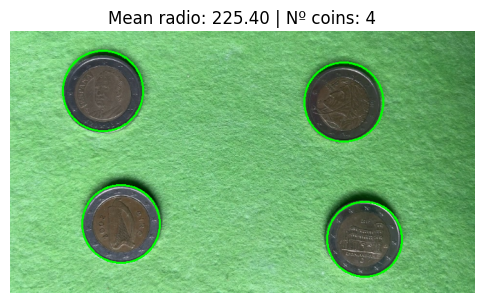

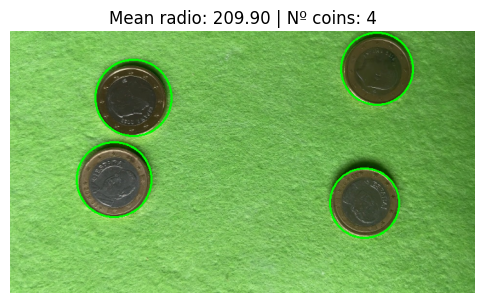

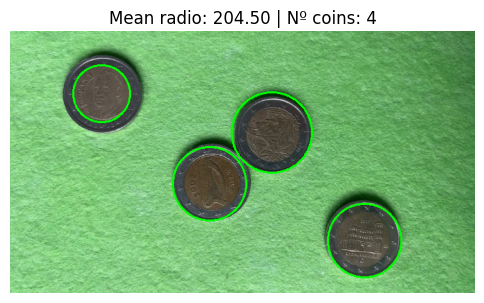

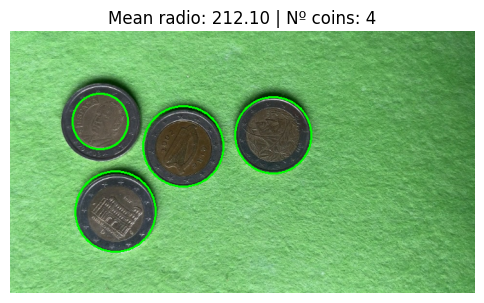

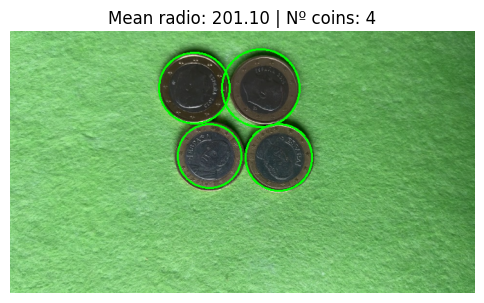

In [234]:
# img_n = img_files_filter[0]
for img_n in img_files_filter:
    img = cv2.imread(img_n)
    img = cv2.resize(img, None, fx = .7, fy=.7)
    circulos = get_circulos(img, median_blur=3, bilateral_filter=7, dp_=.5, param2_=25)
    circs_info = get_circs_info(circulos)
    coins_visualization(img, circulos, circs_info)